<a href="https://colab.research.google.com/github/Punnpd/EDA-Viz-template/blob/main/Hotel_Booking_EDA%26Viz_template.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import math

from typing import List, Dict

# Load Data

In [ ]:
# Get data from csv
df = pd.read_csv('hotel_bookings.csv')
print(df.shape)

(119390, 32)


In [ ]:
# Get a sample of data
df.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


# Data Cleaning

In [ ]:
df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [ ]:
df.isnull().sum()

hotel                                  0
is_canceled                            0
lead_time                              0
arrival_date_year                      0
arrival_date_month                     0
arrival_date_week_number               0
arrival_date_day_of_month              0
stays_in_weekend_nights                0
stays_in_week_nights                   0
adults                                 0
children                               4
babies                                 0
meal                                   0
country                              488
market_segment                         0
distribution_channel                   0
is_repeated_guest                      0
previous_cancellations                 0
previous_bookings_not_canceled         0
reserved_room_type                     0
assigned_room_type                     0
booking_changes                        0
deposit_type                           0
agent                              16340
company         

In [ ]:
# Mapping column to correct format
columns_type_map = {
    'is_canceled': 'object',
    'is_repeated_guest': 'object',
    'reservation_status_date': 'datetime64'
}

df = df.astype(columns_type_map)

In [ ]:
numerical_columns = df.select_dtypes(include=np.number).columns
categorical_columns = df.select_dtypes(include='object').columns
datetime_columns = df.select_dtypes(include='datetime64').columns

print(f'Numerical columns: \n{numerical_columns}\n')
print(f'Categorical columns: \n{categorical_columns}\n')
print(f'Datetime columns: \n{datetime_columns}')

Numerical columns: 
Index(['lead_time', 'arrival_date_year', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies',
       'previous_cancellations', 'previous_bookings_not_canceled',
       'booking_changes', 'agent', 'company', 'days_in_waiting_list', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests'],
      dtype='object')

Categorical columns: 
Index(['hotel', 'is_canceled', 'arrival_date_month', 'meal', 'country',
       'market_segment', 'distribution_channel', 'is_repeated_guest',
       'reserved_room_type', 'assigned_room_type', 'deposit_type',
       'customer_type', 'reservation_status'],
      dtype='object')

Datetime columns: 
Index(['reservation_status_date'], dtype='object')


# Utils

In [ ]:
def plot_continuous_feature_continuous_target(df: pd.DataFrame,
                                              features: List[str], 
                                              target: str, 
                                              rows: int, 
                                              cols: int, 
                                              width: int=500,
                                              height: int=500,
                                              remove_outlier_map: Dict[str, bool]={}
                                              ):
  """
  Create a figure with subplots for each specified continuous feature, 
  showing a scatter plot of each feature against the target variable.
    
  Args:
      df (pd.DataFrame): The input dataframe.
      features (List[str]): A list of column names of continuous features to plot.
      target (str): The column name of the target variable.
      rows (int): The number of rows of subplots in the figure.
      cols (int): The number of columns of subplots in the figure.
      width (int, optional): The width of the figure in pixels. Defaults to 500.
      height (int, optional): The height of the figure in pixels. Defaults to 500.
      remove_outlier_map (Dict[str, bool], optional): A dictionary mapping 
        column names to boolean values indicating whether to remove outliers 
        from the corresponding feature. Defaults to {}.
  
  Returns:
      go.Figure: A Plotly figure object with the subplots.
  """
  fig_nus = make_subplots(rows=rows, 
                           cols=cols, 
                           specs=[[{"secondary_y": True}]*cols]*rows, 
                           subplot_titles=features)
  
  temp_target = df[target] if not remove_outlier_map.get(target) else df[df[target] <= df[target].quantile(0.99)][target]
  
  for i, column in enumerate(features, 1):
    temp_feature = df[column] if not remove_outlier_map.get(column) else df[df[column] <= df[column].quantile(0.99)][column]
    fig_nus.add_trace(
        go.Scattergl(
            x=temp_feature,
            y=temp_target,
            mode='markers',
            marker=dict(
                    size=6,
                    color='#AEC2CA',
                    opacity=0.7,
                )
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
    )

    fig_nus.update_layout(
        title=dict(
            font=dict(
                color='#1E315C',
                family='Courier New',
                size=12
            )
        ),
        font=dict(
            size=12
        ),
        plot_bgcolor='#EEEEEE',
        yaxis_title_text=target,
        height=height,
        width=width,
        margin_l=10,
        margin_r=10,
        margin_t=50,
        margin_b=10,
        showlegend=False,
    )

    fig_nus.update_yaxes(showgrid=True, gridcolor='#F2F2F2')
  
  return fig_nus


In [ ]:
def plot_category_feature_category_target(df: pd.DataFrame, 
                                          features: List[str], 
                                          target: str, 
                                          rows: int, 
                                          cols: int, 
                                          width: int=500,
                                          height: int=500
                                          ) -> go.Figure:
  """
  Create a figure with subplots for each specified categorical feature, 
  showing the count of each category and the percentage of positive target 
  values for each category.
  
  Args:
      df (pd.DataFrame): The input dataframe.
      features (List[str]): A list of column names of categorical features to plot.
      target (str): The column name of the target variable.
      rows (int): The number of rows of subplots in the figure.
      cols (int): The number of columns of subplots in the figure.
      width (int, optional): The width of the figure in pixels. Defaults to 500.
      height (int, optional): The height of the figure in pixels. Defaults to 500.
  
  Returns:
      go.Figure: A Plotly figure object with the subplots.
  """
  fig_cags = make_subplots(rows=rows, 
                           cols=cols, 
                           specs=[[{"secondary_y": True}]*cols]*rows, 
                           subplot_titles=features)
  
  for i, column in enumerate(features, 1):
    feature_count = df[column].value_counts(sort=False).reset_index(name='count').rename(columns={'index': column})
    feature_percentage = df[[target, column]].groupby([column]).value_counts(normalize=True).reset_index(name='count%')
    feature_percentage_specific = feature_percentage[feature_percentage[target]==1]

    fig_cags.add_trace(
        go.Bar(
            x=feature_count[column],
            y=feature_count['count'],
            marker_color='#1E315C',
            opacity=0.8
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=False
    )
    fig_cags.add_trace(
        go.Scatter(
            x=feature_percentage_specific[column],
            y=feature_percentage_specific['count%'],
            mode='markers',
            marker=dict(
                size=6,
                color='#AEC2CA'
            )
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=True
    )
    fig_cags.update_layout(
        title=dict(
            font=dict(
                color='#1E315C',
                family='Courier New',
                size=12
            )
        ),
        font=dict(
            size=12
        ),
        plot_bgcolor='#EEEEEE',
        yaxis_title_text='Count',
        height=height,
        width=width,
        margin_l=10,
        margin_r=10,
        margin_t=50,
        margin_b=10,
        showlegend=False,
    )
    fig_cags.update_yaxes(secondary_y=True, showgrid=False, range = [0,1.1])
    fig_cags.update_yaxes(secondary_y=False, showgrid=True, gridcolor='#F2F2F2')

  return fig_cags

In [ ]:
def plot_ordinal_feature_category_target(df: pd.DataFrame, 
                                        features: List[str], 
                                        target: str, 
                                        rows: int, 
                                        cols: int, 
                                        width: int=500,
                                        height: int=500
                                        ) -> go.Figure:
  """
  Create a figure with subplots for each specified ordinal feature, 
  showing a bar plot of each feature's count, and a scatter plot of 
  each feature's percentage with respect to the target variable.
  
  Args:
      df (pd.DataFrame): The input dataframe.
      features (List[str]): A list of column names of ordinal features to plot.
      target (str): The column name of the target variable.
      rows (int): The number of rows of subplots in the figure.
      cols (int): The number of columns of subplots in the figure.
      width (int, optional): The width of the figure in pixels. Defaults to 500.
      height (int, optional): The height of the figure in pixels. Defaults to 500.
  
  Returns:
      go.Figure: A Plotly figure object with the subplots.
  """
  fig_cags = make_subplots(rows=rows, 
                           cols=cols, 
                           specs=[[{"secondary_y": True}]*cols]*rows, 
                           subplot_titles=features)
  
  for i, column in enumerate(features, 1):
    feature_count = df[column].value_counts(sort=False).reset_index(name='count').rename(columns={'index': column})
    feature_percentage = df[[target, column]].groupby([column]).value_counts(normalize=True).reset_index(name='count%')
    feature_percentage_specific = feature_percentage[feature_percentage[target]==1]

    fig_cags.add_trace(
        go.Bar(
            x=feature_count[column],
            y=feature_count['count'],
            marker_color='#1E315C',
            opacity=0.8
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=False
    )
    fig_cags.add_trace(
        go.Scatter(
            x=feature_percentage_specific[column],
            y=feature_percentage_specific['count%'],
            mode='markers',
            marker=dict(
                size=6,
                color='#AEC2CA'
            )
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=True
    )
    fig_cags.update_layout(
        title=dict(
            font=dict(
                color='#1E315C',
                family='Courier New',
                size=12
            )
        ),
        font=dict(
            size=12
        ),
        plot_bgcolor='#EEEEEE',
        yaxis_title_text='Count',
        height=height,
        width=width,
        margin_l=10,
        margin_r=10,
        margin_t=50,
        margin_b=10,
        showlegend=False,
    )
    fig_cags.update_yaxes(secondary_y=True, showgrid=False, range = [0,1.1])
    fig_cags.update_yaxes(secondary_y=False, showgrid=True, gridcolor='#F2F2F2')

  return fig_cags

In [ ]:
def plot_continuous_feature_category_target(df: pd.DataFrame, 
                                            features: List[str], 
                                            target: str, 
                                            rows: int, 
                                            cols: int, 
                                            bin_s: int=50,
                                            width: int=500,
                                            height: int=500
                                            ) -> go.Figure:
  """
  Plots a histogram of a continuous feature with the target variable 
  overlaid as a scatter plot for each category of a categorical variable.
  
  Args:
  - df: Pandas DataFrame containing the data.
  - features: List of column names containing the categorical features.
  - target: Column name containing the target variable.
  - rows: Number of rows in the subplot grid.
  - cols: Number of columns in the subplot grid.
  - bin_s: The number of bins in the histogram.
  - width: The width of the plot.
  - height: The height of the plot.
  
  Returns:
  - fig_cags: Plotly Figure object containing the subplots.
  """
  fig_cags = make_subplots(rows=rows, 
                           cols=cols, 
                           specs=[[{"secondary_y": True}]*cols]*rows, 
                           subplot_titles=features)
  
  for i, column in enumerate(features, 1):
    target_df = df[target]
    most_value_feature = df[df[column] <= df[column].quantile(0.99)][column]
    bins = pd.cut(most_value_feature, bins=bin_s)
    bin_percentage = pd.concat([target_df, bins], axis=1).groupby([column]).value_counts(normalize=True).reset_index(name='count%')
    bin_percentage_specific = bin_percentage[bin_percentage[target] == 1]

    fig_cags.add_trace(
        go.Histogram(
            x=df[column],
            xbins=dict(
                start=min(most_value_feature),
                end=max(most_value_feature),
                size=float((max(most_value_feature) - min(most_value_feature))/bin_s)
            ),
            autobinx=False,
            marker_color='#1E315C',
            opacity=0.8
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=False
    )
    fig_cags.add_trace(
        go.Scatter(
            x=[x.mid for x in bin_percentage_specific[column]],
            y=bin_percentage_specific['count%'],
            mode='markers',
            marker=dict(
                size=5,
                color='#AEC2CA'
            )
        ),
        row=math.ceil(i/cols),
        col=i%cols if i%cols != 0 else cols,
        secondary_y=True
    )
    fig_cags.update_layout(
        title=dict(
            font=dict(
                color='#1E315C',
                family='Courier New',
                size=12
            )
        ),
        font=dict(
            size=12
        ),
        plot_bgcolor='#EEEEEE',
        yaxis_title_text='Count',
        height=height,
        width=width,
        margin_l=10,
        margin_r=10,
        margin_t=50,
        margin_b=10,
        showlegend=False,
        bargap=0.1
    )
    fig_cags.update_yaxes(secondary_y=True, showgrid=False, range = [0,1.1])
    fig_cags.update_yaxes(secondary_y=False, showgrid=True, gridcolor='#F2F2F2')

  return fig_cags

In [ ]:
# xxx = go.Histogram(
#     x=df['lead_time'],
#     # nbinsx=50,
#     xbins=dict(
#         start=min(df['lead_time']),
#         end=max(df['lead_time']),
#         size=10
#     )
# )
# print(xxx)

# EDA

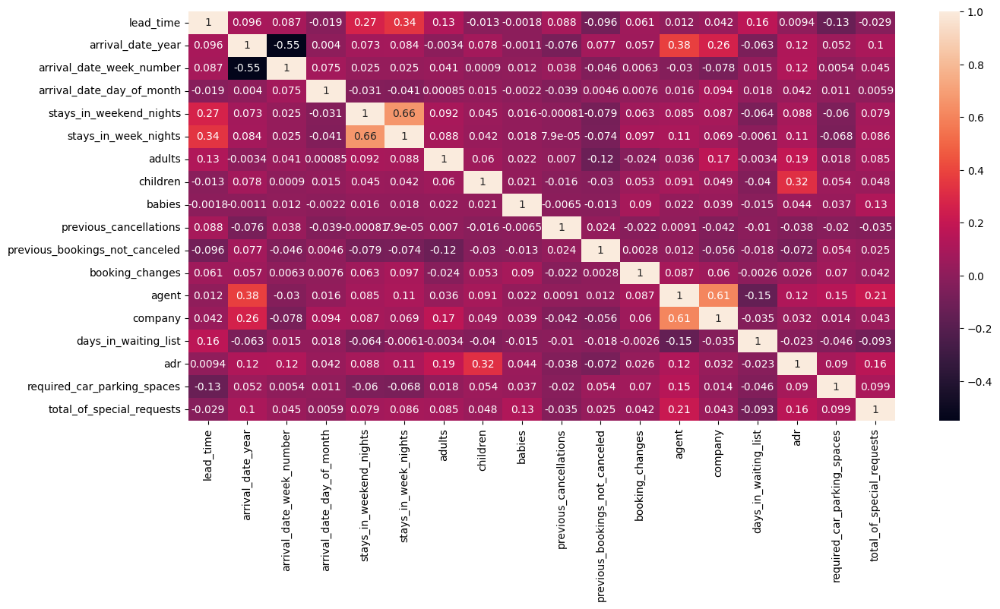

In [ ]:
plt.figure(figsize=(15,7))
corr_matrix = df[numerical_columns].corr()
sns.heatmap(corr_matrix, annot=True)
plt.show()

### Numerical columns

In [ ]:
fig_cags = make_subplots(rows=5, cols=4, subplot_titles=numerical_columns)

for i, column in enumerate(numerical_columns, 1):
  fig_cags.add_trace(
      go.Histogram(
          x=df[column],
          marker_color='#1E315C',
          opacity=0.8
      ),
      row=math.ceil(i/4),
      col=i%4 if i%4 != 0 else 4
  )
  fig_cags.update_layout(
      title=dict(
          font=dict(
              color='#1E315C',
              family='Courier New',
              size=12
          )
      ),
      font=dict(
          size=12
      ),
      plot_bgcolor='#EEEEEE',
      yaxis_title_text='Count',
      height=1200,
      width=1200,
      margin_l=10,
      margin_r=10,
      margin_t=50,
      margin_b=10,
      showlegend=False,
      bargap=0.1
  )

fig_cags.show()

In [ ]:
fig = plot_continuous_feature_category_target(
    df=df,
    features=['lead_time', 'adr'],
    target='is_canceled',
    rows=1,
    cols=2,
    bin_s=50,
    width=1000,
    height=400
)
fig.show()

In [ ]:
fig = plot_ordinal_feature_category_target(
    df=df,
    features=['adults', 'children', 'babies', 'stays_in_weekend_nights', 'stays_in_week_nights', 'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes', 'hotel'],
    target='is_canceled',
    rows=3,
    cols=3,
    width=1200,
    height=600
)
fig.show()

In [ ]:
fig = plot_continuous_feature_continuous_target(
    df=df,
    features=['lead_time', 'stays_in_weekend_nights'],
    target='adr',
    rows=3,
    cols=3,
    width=1200,
    height=700,
    remove_outlier_map={
        'adr': True
    }
)
fig.show()

In [ ]:
fig_cags = make_subplots(rows=5, cols=4, subplot_titles=numerical_columns)

for i, column in enumerate(numerical_columns, 1):
  fig_cags.add_trace(
      go.Box(x=df['is_canceled'], y=df[column]),
      row=math.ceil(i/4),
      col=i%4 if i%4 != 0 else 4
  )

fig_cags.update_layout(
    height=1200,
    width=1200,
    margin_l=5,
    margin_r=5,
    margin_t=50,
    margin_b=5,
    showlegend=False
)
fig_cags.show()

### Categorical columns

In [ ]:
fig = plot_category_feature_category_target(
    df=df,
    features=['market_segment', 'distribution_channel', 'is_repeated_guest', 'reserved_room_type', 'assigned_room_type', 'deposit_type', 'customer_type', 'reservation_status', 'meal'],
    target='is_canceled',
    rows=3,
    cols=3,
    width=1200,
    height=700
)
fig.show()

In [ ]:
# Categorical column by is_canceled
for column in categorical_columns:
  if column != 'is_canceled':
    fig = px.histogram(df, column, color='is_canceled', title=column)
    fig.show()